# Feature extraction: naive methods

In [99]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
import numpy as np
import os
import sys
from copy import deepcopy

import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import pandas as pd
pd.options.display.max_columns = 100
import umap
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


if __package__ is None:

    module_path = os.path.abspath(os.path.join('..'))
    sys.path.append(module_path)

    __package__ = os.path.basename(module_path)


from src.utils.misc.numerical import count_monotonic_group_lengths, find_monotonic_group_idxs, is_within_range
from src.utils.misc.string_handling import string_to_tuple_list
from src.utils.misc.type_handling import flatten_listlike, get_first_elements
from src.utils.results.analytics.naming import get_true_interaction_cols
from src.utils.results.visualisation import hist3d
from explanations.data_enhancing import enhance_data


## Process data

In [ ]:
fn = '../data/ensemble_mutation_effect_analysis/2023_04_11_192013/summarise_simulation/tabulated_mutation_info.csv'
info = pd.read_csv(fn)

In [ ]:
info, infom, info_summ = enhance_data(info) 

/home/wadh6511/Kode/env_circuits/lib/python3.10/site-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/wadh6511/Kode/env_circuits/lib/python3.10/site-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)
/home/wadh6511/Kode/gene-circuit-glitch-prediction/explanations/data_enhancing.py:72: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  mutation_log = grouped[numerical_cols].apply(
/home/wadh6511/Kode/gene-circuit-glitch-prediction/explanations/data_enhancing.py:118: FutureWa

## Features

Convert to Z-scores

In [ ]:
data = info[(info['sample_name'] == 'RNA_1')].dropna(axis=1)
# data = data[np.abs(data[numerical_cols]) < 1e11]
d = data[['sensitivity_wrt_species-6', 'precision_wrt_species-6']]
scaled_data_sp = StandardScaler().fit_transform(d)

Grouped

In [108]:
infom[(infom['idx'] != 'energies_1-0') & (infom['idx'] != 'energies_2-0') & (infom['idx'] != 'energies_2-1')].pivot_table('binding_rates_dissociation', ['idx'], ['circuit_name', 'mutation_name'])


circuit_name  toy_mRNA_circuit_10000                                   \
mutation_name             RNA_0_m1-0 RNA_0_m1-1 RNA_0_m1-2 RNA_0_m1-3   
idx                                                                     
energies_0-0                0.452640   0.452640   0.452640   0.452640   
energies_0-1                0.452640   0.452640   0.452640   0.452640   
energies_0-2                0.014763   0.014044   0.019719   0.452640   
energies_1-1                0.452640   0.452640   0.452640   0.452640   
energies_1-2                0.032168   0.032168   0.032168   0.032168   
energies_2-2                0.452640   0.452640   0.452640   0.452640   

circuit_name                                                           \
mutation_name RNA_0_m1-4 RNA_0_m1-5 RNA_0_m1-6 RNA_0_m1-7 RNA_0_m10-0   
idx                                                                     
energies_0-0    0.452640   0.133654   0.452640   0.452640    0.452640   
energies_0-1    0.452640   0.452640   0.452640   0.452640    0.452640   
energies_0-2    0.122766   0.452640   0.452640   0.452640    0.452640   
energies_1-1    0.452640   0.452640   0.452640   0.452640    0.452640   
energies_1-2    0.032168   0.032168   0.032168   0.032168    0.032168   
energies_2-2    0.452640   0.452640   0.452640   0.452640    0.452640   

circuit_name                                                               \
mutation_name RNA_0_m10-1 RNA_0_m10-2 RNA_0_m10-3 RNA_0_m10-4 RNA_0_m10-5   
idx                                                                         
energies_0-0     0.018665    0.452640    0.452640    0.452640    0.001721   
energies_0-1     0.452640    0.023135    0.452640    0.452640    0.452640   
energies_0-2     0.007166    0.085660    0.007683    0.452640    0.452640   
energies_1-1     0.452640    0.452640    0.452640    0.452640    0.452640   
energies_1-2     0.032168    0.032168    0.032168    0.032168    0.032168   
energies_2-2     0.452640    0.452640    0.452640    0.452640    0.452640   

circuit_name                                                               \
mutation_name RNA_0_m10-6 RNA_0_m10-7 RNA_0_m15-0 RNA_0_m15-1 RNA_0_m15-2   
idx                                                                         
energies_0-0     0.005532    0.452640    0.452640    0.452640    0.452640   
energies_0-1     0.452640    0.452640    0.452640    0.452640    0.024935   
energies_0-2     0.452640    0.051967    0.452640    0.024564    0.452640   
energies_1-1     0.452640    0.452640    0.452640    0.452640    0.452640   
energies_1-2     0.032168    0.032168    0.032168    0.032168    0.032168   
energies_2-2     0.452640    0.452640    0.452640    0.452640    0.452640   

circuit_name                                                               \
mutation_name RNA_0_m15-3 RNA_0_m15-4 RNA_0_m15-5 RNA_0_m15-6 RNA_0_m15-7   
idx                                                                         
energies_0-0     0.452640    0.452640    0.452640    0.452640    0.452640   
energies_0-1     0.452640    0.452640    0.452640    0.452640    0.452640   
energies_0-2     0.452640    0.002762    0.452640    0.452640    0.452640   
energies_1-1     0.452640    0.452640    0.452640    0.452640    0.452640   
energies_1-2     0.032168    0.032168    0.032168    0.032168    0.032168   
energies_2-2     0.452640    0.452640    0.452640    0.452640    0.452640   

circuit_name                                                          \
mutation_name RNA_0_m3-0 RNA_0_m3-1 RNA_0_m3-2 RNA_0_m3-3 RNA_0_m3-4   
idx                                                                    
energies_0-0    0.001415   0.014399   0.452640   0.452640   0.452640   
energies_0-1    0.452640   0.452640   0.452640   0.452640   0.452640   
energies_0-2    0.019329   0.452640   0.452640   0.076740   0.452640   
energies_1-1    0.452640   0.452640   0.452640   0.452640   0.452640   
energies_1-2    0.032168   0.032168   0.032168   0.032168   0.032168   
energies_2-2    0.452640  

In [109]:
# grp_mutations = infom.pivot_table('binding_rates_dissociation', ['sample_name', 'mutation_name', 'idx'], 'circuit_name').T.to_numpy()
grp_mutations = infom[(infom['idx'] != 'energies_1-0') & (infom['idx'] != 'energies_2-0') & (infom['idx'] != 'energies_2-1')].pivot_table('binding_rates_dissociation', ['idx'], ['circuit_name', 'mutation_name']).T.to_numpy()
scaled_data = StandardScaler().fit_transform(grp_mutations)


In [110]:
grp_mutations.shape

(121000, 6)

## UMAP

In [ ]:
# fig = px.scatter_3d(
#     mutation_log,
#     x=embedding[:, 0], y=embedding[:, 1], z='sp_distance', 
#     color=[sns.color_palette()[x] for x in info['sample_name'].map({"RNA_0":0, "RNA_1":1, "RNA_2":2})])
# fig.show()

fig = hist3d(data=None, x=embedding[:, 0], y=embedding[:, 1])
fig.show()

In [ ]:
digits_df = pd.DataFrame(digits.data[:,1:11])
digits_df['digit'] = pd.Series(digits.target).map(lambda x: 'Digit {}'.format(x))
sns.pairplot(digits_df, hue='digit', palette='Spectral');

## TSNE

### TSNE on precision vs. sensitivity

In [ ]:
tsne = TSNE(n_components=2, random_state=0)
projections = tsne.fit_transform(d)

In [ ]:
data['projection_0'] = projections[:, 0]
data['projection_1'] = projections[:, 1]

In [ ]:

fig = px.scatter(
    data, x='projection_0', y='projection_1',
    color='num_interacting_all', labels={'color': 'num_interacting_all'},
    hover_name="circuit_name"
)
fig.show()

### Multi-value per circuit

In [112]:
projections_g = np.array([])
for seed in np.arange(5):
    tsne = TSNE(n_components=2, random_state=seed)
    p = tsne.fit_transform(grp_mutations)
    if len(projections_g):
        projections_g = np.concatenate([projections_g, p])
    else:
        projections_g = p

Visualise

In [113]:
def visualise_embedding(embedding_matrix, i=0, j=1, algorithm='T-SNE'):
    for h in ['mutation_num', 'frac_muts_in_binding_site', 'num_interacting_all', 'num_interacting', 'num_self_interacting', 'sensitivity_wrt_species-6', 'precision_wrt_species-6', 'RMSE', 'fold_change', 'overshoot', 'energies', 'binding_rates_dissociation', 'eqconstants']:
        hue = [
            infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'mean'}).to_numpy().squeeze(),
            infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'std'}).to_numpy().squeeze(),
            infom.groupby(['circuit_name', 'mutation_name']).agg({h: lambda x: np.std(x) / np.where(np.mean(x) != 0, np.mean(x), 1)}).to_numpy().squeeze()
        ]
        # if h in ['sensitivity_wrt_species-6', 'precision_wrt_species-6']:
        #     hue = [np.log(x) for x in hue]

        plt.figure(figsize=(28, 8))
        ax = plt.subplot(1,3,1)
        sns.scatterplot(
            x=embedding_matrix[:, i],
            y=embedding_matrix[:, j],
            hue=hue[0]
        )
        plt.legend(title=h + '_mean')
        plt.ylabel(f'{algorithm} {j}')
        ax = plt.subplot(1,3,2)
        sns.scatterplot(
            x=embedding_matrix[:, i],
            y=embedding_matrix[:, j],
            hue=hue[1]
        )
        plt.xlabel(f'{algorithm} {i}')
        plt.legend(title=h + '_std')
        ax = plt.subplot(1,3,3)
        sns.scatterplot(
            x=embedding_matrix[:, i],
            y=embedding_matrix[:, j],
            hue=hue[2]
        )
        plt.legend(title=h + '_std_normed_by_mean')
        plt.gca().set_aspect('equal', 'datalim')
        

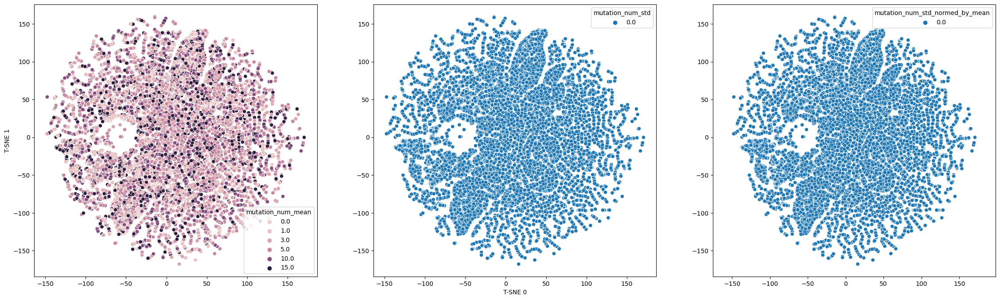

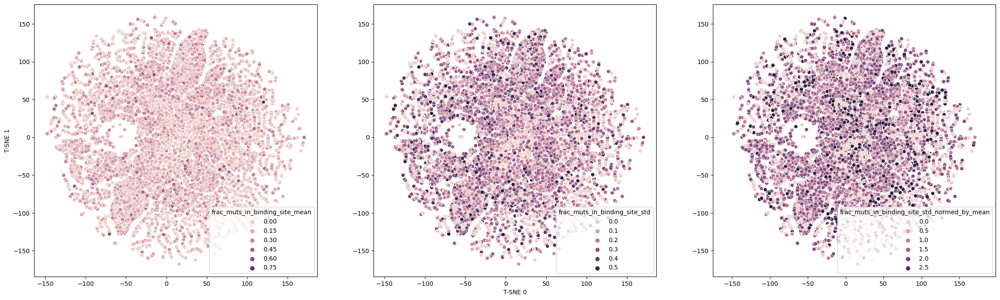

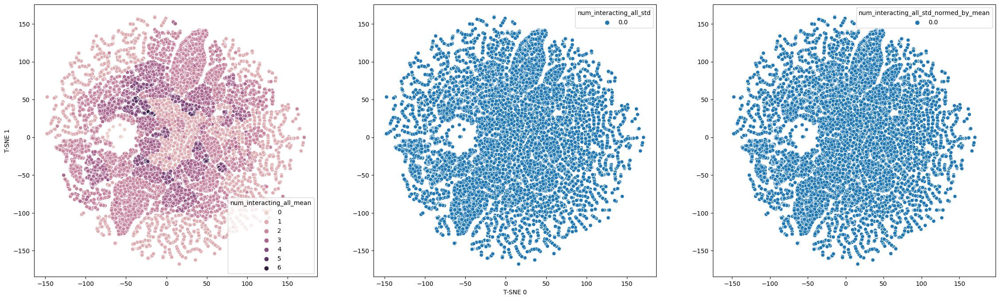

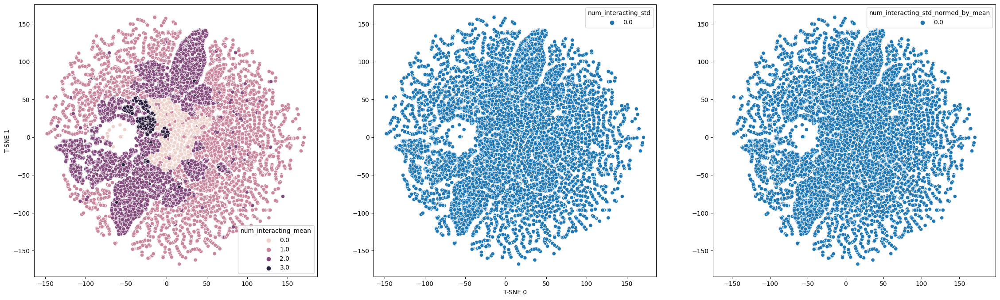

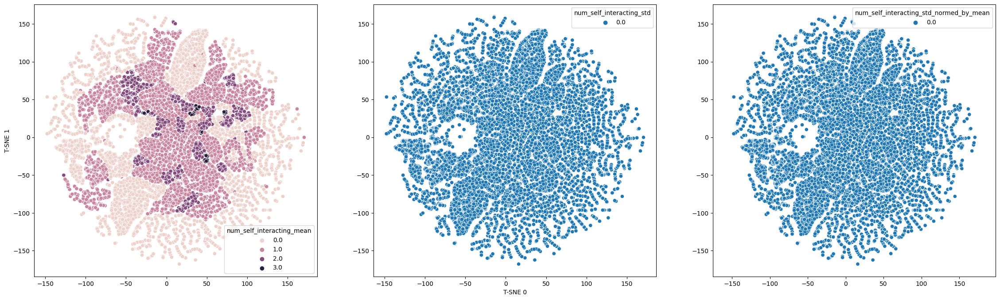

...

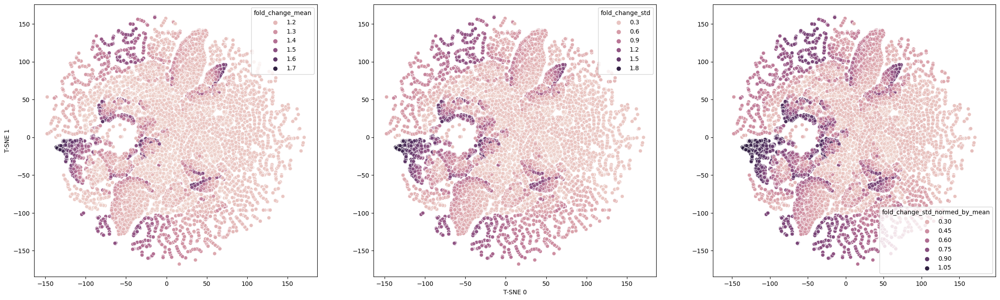

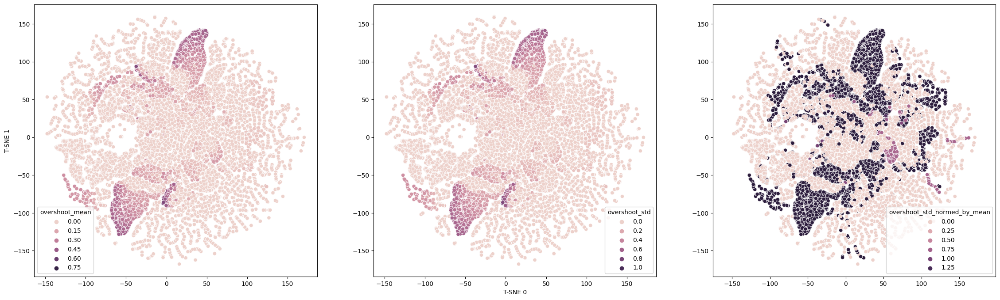

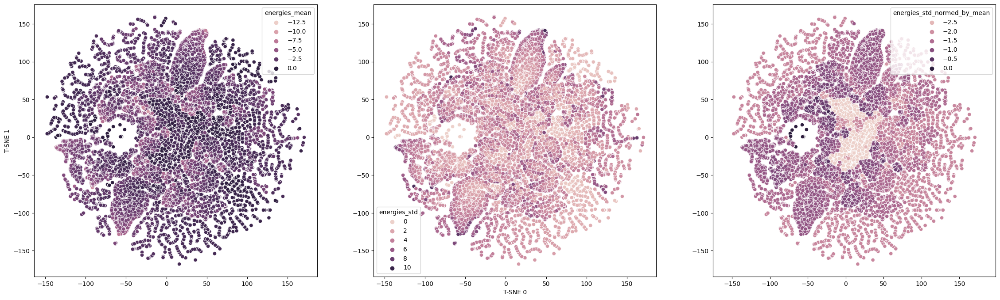

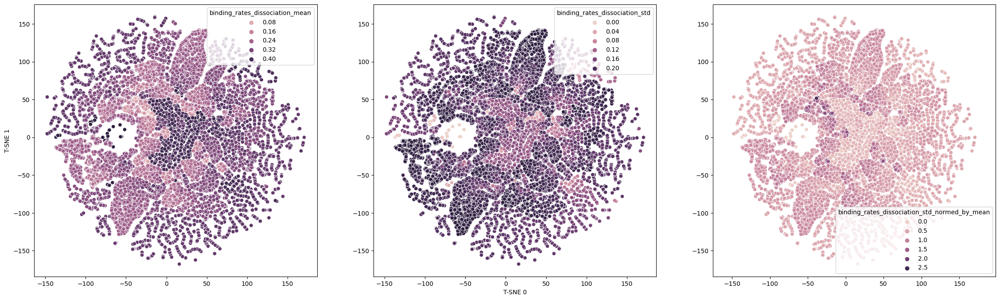

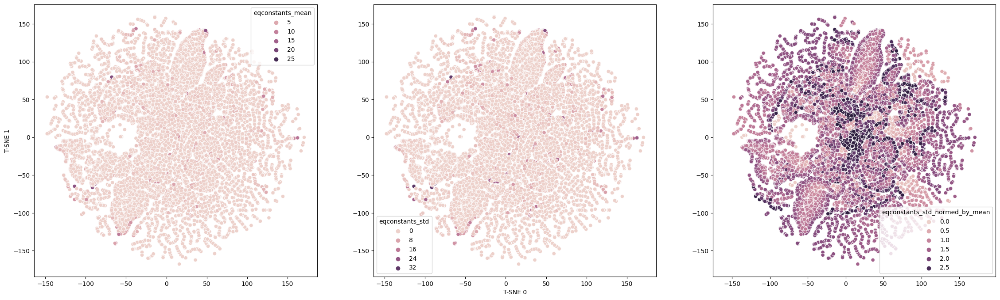

In [114]:
projections_g_mean = projections_g.reshape((5, grp_mutations.shape[0], 2)).mean(axis=0)
visualise_embedding(projections_g_mean)

## PCA

In [115]:
pca = PCA(n_components=3)
pca_embedding = pca.fit_transform(grp_mutations)

In [116]:
pca_embedding.shape

(121000, 3)

In [ ]:

h = 'num_interacting_all'
fig = px.scatter(
    info[info['sample_name'] == 'RNA_0'], x=pca_embedding[:, 0], y=pca_embedding[:, 2],
    color=infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'mean'}).to_numpy().squeeze(), 
    labels={'color': h},
    hover_name="circuit_name",
    hover_data=['interacting', 'self_interacting']
)
fig.show()

In [ ]:
visualise_embedding(pca_embedding, i=0, j = 2, algorithm='PCA')


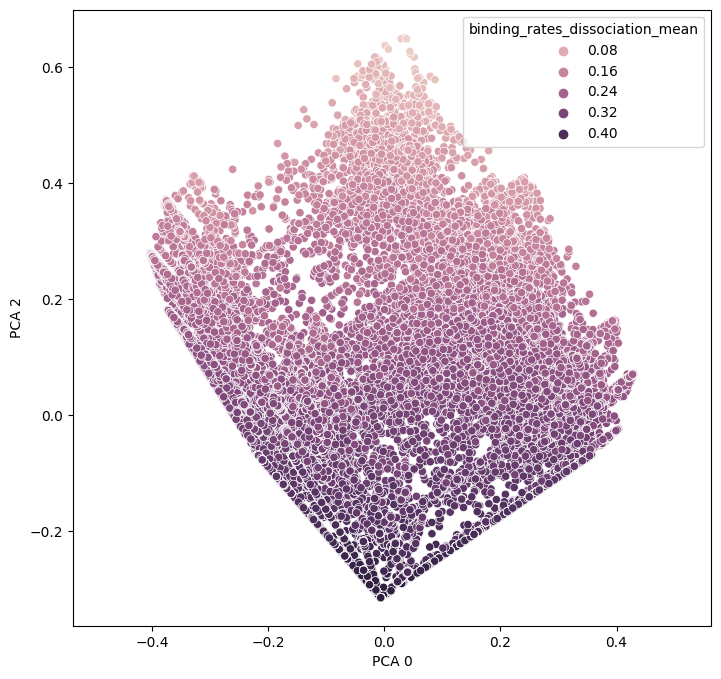

In [117]:
h = 'binding_rates_dissociation'
# h = 'sensitivity_wrt_species-6'
embedding_matrix = pca_embedding
algorithm = 'PCA'
# for i in np.arange(1, 6):
#     for j in np.arange(i, 6):
i = 0
j = 2
hue = [
    infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'mean'}).to_numpy().squeeze(),
    # infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'std'}).to_numpy().squeeze(),
    # infom.groupby(['circuit_name', 'mutation_name']).agg({h: lambda x: np.std(x) / np.where(np.mean(x) != 0, np.mean(x), 1)}).to_numpy().squeeze()
]
# if h in ['sensitivity_wrt_species-6', 'precision_wrt_species-6']:
#     hue = [np.log(x) for x in hue]

plt.figure(figsize=(28, 8))
ax = plt.subplot(1,3,1)
sns.scatterplot(
    x=embedding_matrix[:, i],
    y=embedding_matrix[:, j],
    hue=hue[0]
)
plt.legend(title=h + '_mean')
plt.ylabel(f'{algorithm} {j}')
# ax = plt.subplot(1,3,2)
# sns.scatterplot(
#     x=embedding_matrix[:, i],
#     y=embedding_matrix[:, j],
#     hue=hue[1]
# )
plt.xlabel(f'{algorithm} {i}')
# plt.legend(title=h + '_std')
# ax = plt.subplot(1,3,3)
# sns.scatterplot(
#     x=embedding_matrix[:, i],
#     y=embedding_matrix[:, j],
#     hue=hue[2]
# )
# plt.legend(title=h + '_std_normed_by_mean')
plt.gca().set_aspect('equal', 'datalim')

In [118]:
pca.explained_variance_ratio_

array([0.21884375, 0.21785629, 0.1529814 ])

## Quick binding energy examination

<AxesSubplot: xlabel='binding_rates_dissociation_1-1', ylabel='binding_rates_dissociation_0-1'>

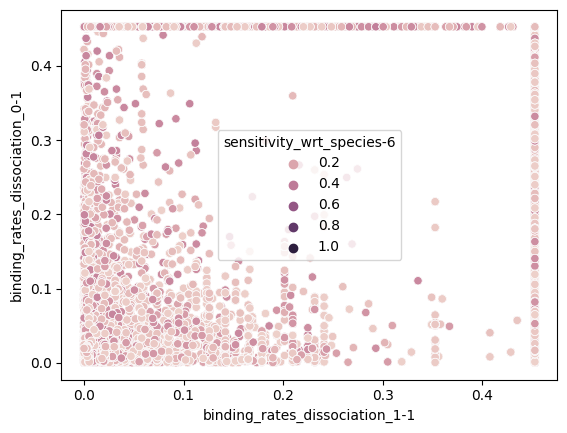

In [120]:
sns.scatterplot(info, x='binding_rates_dissociation_1-1', y='binding_rates_dissociation_0-1', hue='sensitivity_wrt_species-6')

In [122]:
sns.histplot(infom[infom['idx'] == 'energies_0-0'], x='sensitivity_wrt_species-6' + '_std', hue='mutation_num', element='step')

ValueError: Could not interpret value `sensitivity_wrt_species-6_std` for parameter `x`